# Business Objective:-
-1.Can we predict whether a customer will churn or not based on their telecommunications usage patterns and demographic information?

-2.What are the factors that contribute the most to customer churn in the telecommunications industry, and how can we use this information to develop targeted retention strategies?

-3.How can we optimize our retention strategies to reduce customer churn and increase customer loyalty, based on the customer data we have available?

-4.Are there any significant differences in telecommunications usage patterns and customer demographics between customers who churn and those who remain loyal, and how can we leverage this information to improve our customer retention efforts?

-5.Can we develop a machine learning model to accurately predict customer churn in real-time, and use this model to proactively intervene with customers who are at high risk of leaving the company?

# Required Labraries

In [1]:
# Importing Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns
from collections import Counter
from imblearn.over_sampling import SMOTE,  ADASYN
from imblearn.combine import SMOTETomek, SMOTEENN
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
from dataprep.eda import plot, plot_correlation, plot_missing, create_report
import plotly.express as px
from plotly.offline import plot as off
import plotly.figure_factory as ff
import plotly.io as pio
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.tree import  DecisionTreeClassifier
from sklearn import tree
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report,confusion_matrix,accuracy_score, roc_auc_score, roc_curve, precision_recall_curve
from sklearn.model_selection import GridSearchCV, KFold, StratifiedKFold, cross_val_score, train_test_split, RandomizedSearchCV
import warnings
warnings.filterwarnings('ignore')

In [2]:
#load Dataset
tele_df = pd.read_csv("churn.csv", index_col=0)

# Understand More About The Data

In [3]:
tele_df.head()

,area_code,account.length,eve.charge,voice.plan,night.mins,customer.calls,intl.plan,eve.mins,day.charge,voice.messages,day.mins,Churn,intl.mins,intl.calls,intl.charge,day.calls,eve.calls,night.calls,night.charge
state,,,,,,,,,,,,,,,,,,,
KS,area_code_415,128,16.78,yes,244.7,1,no,197.4,45.07,25,265.1,no,10.0,3,2.70,110.0,99,91,11.01
OH,area_code_415,107,16.62,yes,254.4,1,no,195.5,27.47,26,161.6,no,13.7,3,3.70,123.0,103,103,11.45
NJ,area_code_415,137,10.30,no,162.6,0,no,121.2,41.38,0,243.4,no,12.2,5,3.29,114.0,110,104,7.32
OH,area_code_408,84,5.26,no,196.9,2,yes,61.9,50.9,0,299.4,no,6.6,7,1.78,71.0,88,89,8.86
OK,area_code_415,75,12.61,no,186.9,3,yes,148.3,28.34,0,166.7,no,10.1,3,2.73,113.0,122,121,8.41


In [4]:
tele_df.describe(include='all')

,area_code,account.length,eve.charge,voice.plan,night.mins,customer.calls,intl.plan,eve.mins,day.charge,voice.messages,day.mins,Churn,intl.mins,intl.calls,intl.charge,day.calls,eve.calls,night.calls,night.charge
count,5000,5000.00000,5000.000000,5000,5000.000000,5000.000000,5000,5000,5000,5000.000000,5000.000000,5000,5000.000000,5000.000000,5000.000000,4999.000000,5000.000000,5000.000000,5000.000000
unique,3,NaN,NaN,2,NaN,NaN,2,1877,1962,NaN,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,area_code_415,NaN,NaN,no,NaN,NaN,no,Nan,26.18,NaN,NaN,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,2495,NaN,NaN,3677,NaN,NaN,4527,24,10,NaN,NaN,4293,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,100.25860,17.054322,NaN,200.391620,1.570400,NaN,NaN,NaN,7.755200,180.288900,NaN,10.261780,4.435200,2.771196,100.021604,100.191000,99.919200,9.017732
std,NaN,39.69456,4.296843,NaN,50.527789,1.306363,NaN,NaN,NaN,13.546393,53.894699,NaN,2.761396,2.456788,0.745514,19.825518,19.826496,19.958686,2.273763
min,NaN,1.00000,0.000000,NaN,0.000000,0.000000,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,NaN,73.00000,14.140000,NaN,166.900000,1.000000,NaN,NaN,NaN,0.000000,143.700000,NaN,8.500000,3.000000,2.300000,87.000000,87.000000,87.000000,7.510000
50%,NaN,100.00000,17.090000,NaN,200.400000,1.000000,NaN,NaN,NaN,0.000000,180.100000,NaN,10.300000,4.000000,2.780000,100.000000,100.000000,100.000000,9.020000
75%,NaN,127.00000,19.900000,NaN,234.700000,2.000000,NaN,NaN,NaN,17.000000,216.200000,NaN,12.000000,6.000000,3.240000,113.000000,114.000000,113.000000,10.560000


In [5]:
#view the dataset below 5 rows to look the glimps of data
tele_df.tail()

,area_code,account.length,eve.charge,voice.plan,night.mins,customer.calls,intl.plan,eve.mins,day.charge,voice.messages,day.mins,Churn,intl.mins,intl.calls,intl.charge,day.calls,eve.calls,night.calls,night.charge
state,,,,,,,,,,,,,,,,,,,
HI,area_code_408,50,18.96,yes,297.5,2,no,223,40.07,40,235.7,no,9.9,5,2.67,127.0,126,116,13.39
WV,area_code_415,152,21.83,no,213.6,3,no,256.8,31.31,0,184.2,yes,14.7,2,3.97,90.0,73,113,9.61
DC,area_code_415,61,14.69,no,212.4,1,no,172.8,23.9,0,140.6,no,13.6,4,3.67,89.0,128,97,9.56
DC,area_code_510,109,14.59,no,224.4,0,no,171.7,32.1,0,188.8,no,8.5,6,2.30,67.0,92,89,10.10
VT,area_code_415,86,22.70,yes,154.8,0,no,267.1,22,34,129.4,no,9.3,16,2.51,102.0,104,100,6.97


In [6]:
#getting the shape of dataset with row and columns
tele_df.shape

(5000, 19)

In [7]:
tele_df.dtypes

area_code          object
account.length      int64
eve.charge        float64
voice.plan         object
night.mins        float64
customer.calls      int64
intl.plan          object
eve.mins           object
day.charge         object
voice.messages      int64
day.mins          float64
Churn              object
intl.mins         float64
intl.calls          int64
intl.charge       float64
day.calls         float64
eve.calls           int64
night.calls         int64
night.charge      float64
dtype: object

In [8]:
# day charge is obj, eve mins is obj

In [9]:
#getting types of dataset and details about dataset
tele_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5000 entries, KS to VT
Data columns (total 19 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   area_code       5000 non-null   object 
 1   account.length  5000 non-null   int64  
 2   eve.charge      5000 non-null   float64
 3   voice.plan      5000 non-null   object 
 4   night.mins      5000 non-null   float64
 5   customer.calls  5000 non-null   int64  
 6   intl.plan       5000 non-null   object 
 7   eve.mins        5000 non-null   object 
 8   day.charge      5000 non-null   object 
 9   voice.messages  5000 non-null   int64  
 10  day.mins        5000 non-null   float64
 11  Churn           5000 non-null   object 
 12  intl.mins       5000 non-null   float64
 13  intl.calls      5000 non-null   int64  
 14  intl.charge     5000 non-null   float64
 15  day.calls       4999 non-null   float64
 16  eve.calls       5000 non-null   int64  
 17  night.calls     5000 non-null   int64  

In [10]:
print('features of data set:')
tele_df.columns

features of data set:


Index(['area_code', 'account.length', 'eve.charge', 'voice.plan', 'night.mins',
       'customer.calls', 'intl.plan', 'eve.mins', 'day.charge',
       'voice.messages', 'day.mins', 'Churn', 'intl.mins', 'intl.calls',
       'intl.charge', 'day.calls', 'eve.calls', 'night.calls', 'night.charge'],
      dtype='object')

In [11]:
day_charge =tele_df['day.charge'].astype(float)
eve_mins = tele_df['eve.mins'].astype(float)
tele_df['day.charge'] = day_charge
tele_df['eve.mins'] = eve_mins

In [12]:
tele_df.dtypes

area_code          object
account.length      int64
eve.charge        float64
voice.plan         object
night.mins        float64
customer.calls      int64
intl.plan          object
eve.mins          float64
day.charge        float64
voice.messages      int64
day.mins          float64
Churn              object
intl.mins         float64
intl.calls          int64
intl.charge       float64
day.calls         float64
eve.calls           int64
night.calls         int64
night.charge      float64
dtype: object

In [13]:
tele_df.nunique()

area_code            3
account.length     218
eve.charge        1659
voice.plan           2
night.mins        1853
customer.calls      10
intl.plan            2
eve.mins          1876
day.charge        1961
voice.messages      48
day.mins          1961
Churn                2
intl.mins          170
intl.calls          21
intl.charge        170
day.calls          123
eve.calls          126
night.calls        131
night.charge      1028
dtype: int64

In [14]:
tele_df[tele_df.duplicated()].shape

(0, 19)

In [15]:
#looking for the Description of the dataset to get insights of the data
tele_df.describe(include='all')

,area_code,account.length,eve.charge,voice.plan,night.mins,customer.calls,intl.plan,eve.mins,day.charge,voice.messages,day.mins,Churn,intl.mins,intl.calls,intl.charge,day.calls,eve.calls,night.calls,night.charge
count,5000,5000.00000,5000.000000,5000,5000.000000,5000.000000,5000,4976.000000,4993.000000,5000.000000,5000.000000,5000,5000.000000,5000.000000,5000.000000,4999.000000,5000.000000,5000.000000,5000.000000
unique,3,NaN,NaN,2,NaN,NaN,2,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,area_code_415,NaN,NaN,no,NaN,NaN,no,NaN,NaN,NaN,NaN,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,2495,NaN,NaN,3677,NaN,NaN,4527,NaN,NaN,NaN,NaN,4293,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,100.25860,17.054322,NaN,200.391620,1.570400,NaN,200.580326,30.653501,7.755200,180.288900,NaN,10.261780,4.435200,2.771196,100.021604,100.191000,99.919200,9.017732
std,NaN,39.69456,4.296843,NaN,50.527789,1.306363,NaN,50.554637,9.166356,13.546393,53.894699,NaN,2.761396,2.456788,0.745514,19.825518,19.826496,19.958686,2.273763
min,NaN,1.00000,0.000000,NaN,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,NaN,73.00000,14.140000,NaN,166.900000,1.000000,NaN,166.275000,24.430000,0.000000,143.700000,NaN,8.500000,3.000000,2.300000,87.000000,87.000000,87.000000,7.510000
50%,NaN,100.00000,17.090000,NaN,200.400000,1.000000,NaN,201.000000,30.620000,0.000000,180.100000,NaN,10.300000,4.000000,2.780000,100.000000,100.000000,100.000000,9.020000
75%,NaN,127.00000,19.900000,NaN,234.700000,2.000000,NaN,234.100000,36.750000,17.000000,216.200000,NaN,12.000000,6.000000,3.240000,113.000000,114.000000,113.000000,10.560000


In [16]:
tele_df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
area_code,5000,3,area_code_415,2495,NaN,NaN,NaN,NaN,NaN,NaN,NaN
account.length,5000.0,NaN,NaN,NaN,100.2586,39.69456,1.0,73.0,100.0,127.0,243.0
eve.charge,5000.0,NaN,NaN,NaN,17.054322,4.296843,0.0,14.14,17.09,19.9,30.91
voice.plan,5000,2,no,3677,NaN,NaN,NaN,NaN,NaN,NaN,NaN
night.mins,5000.0,NaN,NaN,NaN,200.39162,50.527789,0.0,166.9,200.4,234.7,395.0
customer.calls,5000.0,NaN,NaN,NaN,1.5704,1.306363,0.0,1.0,1.0,2.0,9.0
intl.plan,5000,2,no,4527,NaN,NaN,NaN,NaN,NaN,NaN,NaN
eve.mins,4976.0,NaN,NaN,NaN,200.580326,50.554637,0.0,166.275,201.0,234.1,363.7
day.charge,4993.0,NaN,NaN,NaN,30.653501,9.166356,0.0,24.43,30.62,36.75,59.76
voice.messages,5000.0,NaN,NaN,NaN,7.7552,13.546393,0.0,0.0,0.0,17.0,52.0


In [17]:
#printing count of true and flase in'churn' feature
#0 = flase & 1 = true
tele_df.Churn.value_counts()

no     4293
yes     707
Name: Churn, dtype: int64

In [18]:
# Identifying categorical and numerical data types
cat_features = [feat for feat in tele_df.columns if tele_df[feat].dtype == 'object']
num_features = [feat for feat in tele_df.columns if tele_df[feat].dtype != 'object']

# Identifying discrete and continuous numerical features
discrete_features = [feat for feat in num_features if len(tele_df[feat].unique()) < 25]
continuous_features = [feat for feat in num_features if feat not in discrete_features]

print(f"Discrete variable count: {len(discrete_features)}")
print(f"Continuous variable count: {len(continuous_features)}")

Discrete variable count: 2
Continuous variable count: 13


# Checking missing value and duplicate values

In [19]:
# check for count of missing value in each column.
tele_df.isna().sum()
tele_df.isnull().sum()

area_code          0
account.length     0
eve.charge         0
voice.plan         0
night.mins         0
customer.calls     0
intl.plan          0
eve.mins          24
day.charge         7
voice.messages     0
day.mins           0
Churn              0
intl.mins          0
intl.calls         0
intl.charge        0
day.calls          1
eve.calls          0
night.calls        0
night.charge       0
dtype: int64

missing values were found in two of the columns: day.charge, eve.mins

<function matplotlib.pyplot.show(close=None, block=None)>

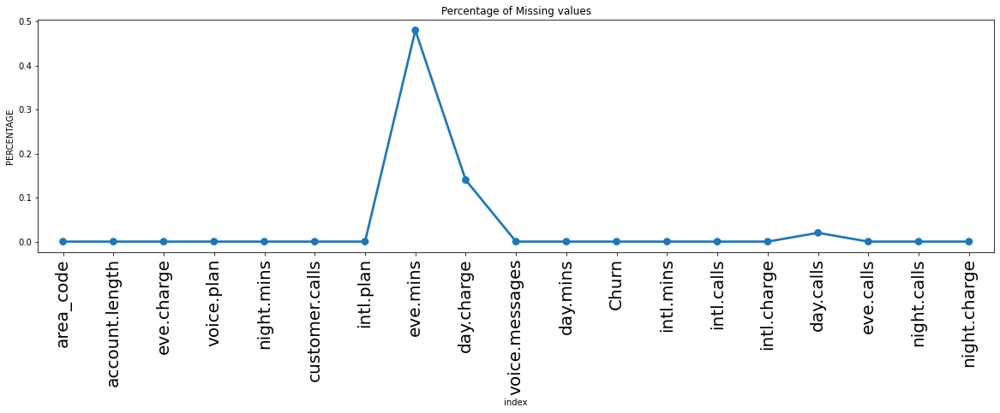

In [20]:
# % Missing Value visualization

missing = pd.DataFrame((tele_df.isnull().sum())*100/tele_df.shape[0]).reset_index()
plt.figure(figsize=(20,5))
ax = sns.pointplot('index',0,data=missing)
plt.xticks(rotation =90,fontsize =20)
plt.title("Percentage of Missing values")
plt.ylabel("PERCENTAGE")
plt.show

In [21]:
tele_df=tele_df.dropna()

In [22]:
#since the percentage of null values were less we could just drop them

In [23]:
tele_df.isnull().sum()

area_code         0
account.length    0
eve.charge        0
voice.plan        0
night.mins        0
customer.calls    0
intl.plan         0
eve.mins          0
day.charge        0
voice.messages    0
day.mins          0
Churn             0
intl.mins         0
intl.calls        0
intl.charge       0
day.calls         0
eve.calls         0
night.calls       0
night.charge      0
dtype: int64

In [24]:
tele_df.corr()

,account.length,eve.charge,night.mins,customer.calls,eve.mins,day.charge,voice.messages,day.mins,intl.mins,intl.calls,intl.charge,day.calls,eve.calls,night.calls,night.charge
account.length,1.000000,-0.007476,0.001060,-0.002490,-0.007480,-0.000694,-0.013576,-0.000692,0.004265,0.014673,0.004272,0.027721,0.008147,-0.008175,0.001049
eve.charge,-0.007476,1.000000,-0.016506,-0.011812,1.000000,-0.011676,0.018077,-0.011679,-0.000949,0.007466,-0.000929,-0.002152,0.002609,0.016745,-0.016508
night.mins,0.001060,-0.016506,1.000000,-0.007263,-0.016498,0.011895,0.004726,0.011893,-0.005615,-0.017289,-0.005553,0.002896,0.001822,0.026104,0.999999
customer.calls,-0.002490,-0.011812,-0.007263,1.000000,-0.011799,0.002594,-0.006552,0.002599,-0.010728,-0.019535,-0.010782,-0.010770,0.005940,-0.008540,-0.007261
eve.mins,-0.007480,1.000000,-0.016498,-0.011799,1.000000,-0.011667,0.018071,-0.011670,-0.000943,0.007460,-0.000923,-0.002155,0.002594,0.016743,-0.016500
day.charge,-0.000694,-0.011676,0.011895,0.002594,-0.011667,1.000000,0.005552,1.000000,-0.018419,-0.000533,-0.018345,-0.000460,0.006619,0.004166,0.011878
voice.messages,-0.013576,0.018077,0.004726,-0.006552,0.018071,0.005552,1.000000,0.005556,0.001131,-0.000920,0.001172,0.000446,-0.003536,0.002262,0.004718
day.mins,-0.000692,-0.011679,0.011893,0.002599,-0.011670,1.000000,0.005556,1.000000,-0.018415,-0.000530,-0.018341,-0.000460,0.006618,0.004167,0.011876
intl.mins,0.004265,-0.000949,-0.005615,-0.010728,-0.000943,-0.018419,0.001131,-0.018415,1.000000,0.016652,0.999993,0.013785,-0.005966,0.000752,-0.005611
intl.calls,0.014673,0.007466,-0.017289,-0.019535,0.007460,-0.000533,-0.000920,-0.000530,0.016652,1.000000,0.016763,0.011531,0.006657,-0.000037,-0.017258


* NO any duplicate value in present data set
* there are 3333 rows and 20 columns
* & one datatype is boolen = (churn)
* 8 flot data type & 8 interger data type
 


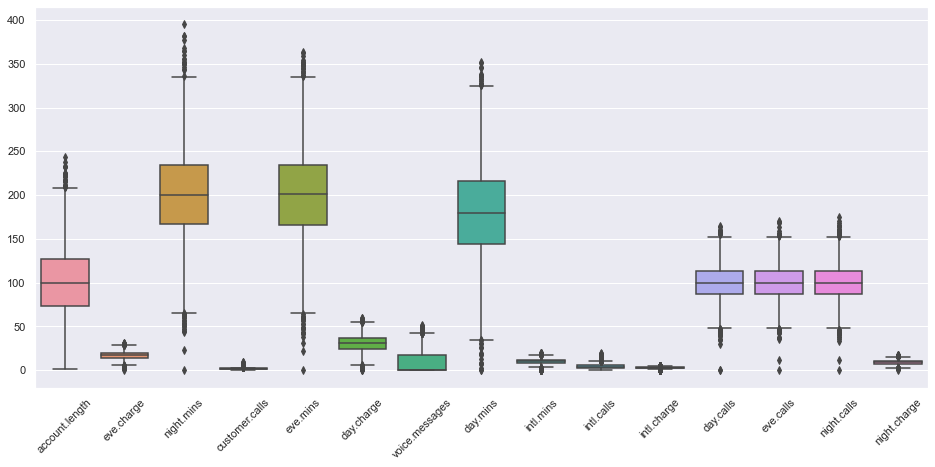

In [25]:
sns.set(style="darkgrid", palette="muted")
fig, ax = plt.subplots(figsize=(16,7))
sns.boxplot(data=tele_df)
plt.xticks(rotation=45)
plt.show()

In [26]:
tele_df.unimputed=tele_df.copy

In [27]:
# Identifying numerical columns with outliers
num_features = tele_df.select_dtypes(include=[np.number]).columns
outlier_cols = []
for col in num_features:
    q1 = tele_df[col].quantile(0.25)
    q3 = tele_df[col].quantile(0.75)
    iqr = q3 - q1
    lower = q1 - 1.5*iqr
    upper = q3 + 1.5*iqr
    if tele_df[(tele_df[col] < lower) | (tele_df[col] > upper)].shape[0] > 0:
        outlier_cols.append(col)

In [28]:
# Imputing outliers with the median value
for col in outlier_cols:
    median_val = tele_df[col].median()
    tele_df[col] = tele_df[col].clip(lower=tele_df[col].quantile(0.05), upper=tele_df[col].quantile(0.95)).fillna(median_val)

# Save the imputed dataset to a new file
tele_df.to_csv('my_dataset_imputed.csv', index=False)

# Load the imputed dataset into a Pandas DataFrame
tele_df = pd.read_csv('my_dataset_imputed.csv')

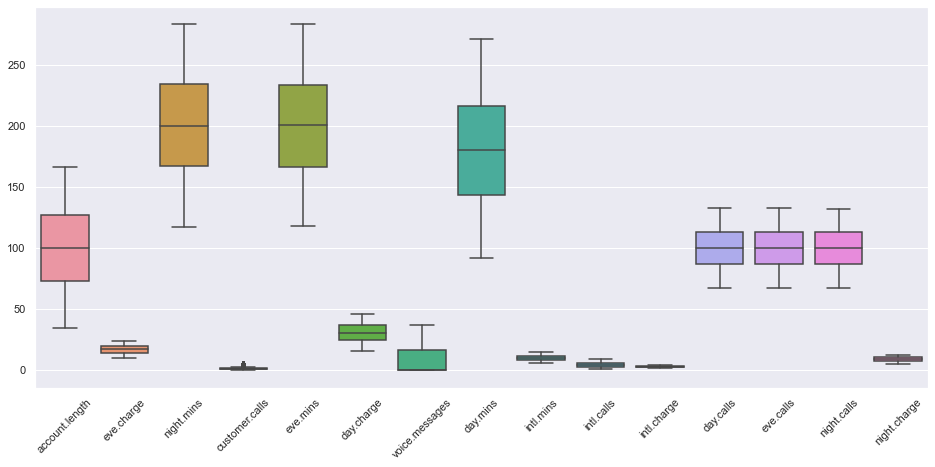

In [29]:
sns.set(style="darkgrid", palette="muted")
fig, ax = plt.subplots(figsize=(16,7))
sns.boxplot(data=tele_df)
plt.xticks(rotation=45)
plt.show()

Analyzing what the dependent variable said to us(Churn)

In [30]:
#unique value inside 'churn' column
tele_df['Churn'].unique()

array(['no', 'yes'], dtype=object)

In [31]:
#count of true & false in ' churn'
tele_df.Churn.value_counts()

no     4263
yes     705
Name: Churn, dtype: int64

In [32]:
import plotly.express as px
target_instance = tele_df["Churn"].value_counts().to_frame()
target_instance = target_instance.reset_index()
target_instance = target_instance.rename(columns={'index': 'Category'})
fig = px.pie(target_instance, values='Churn', names='Category', color_discrete_sequence=["green", "red"],
             title='Distribution of Churn')
fig.show()

<AxesSubplot:xlabel='Churn', ylabel='count'>

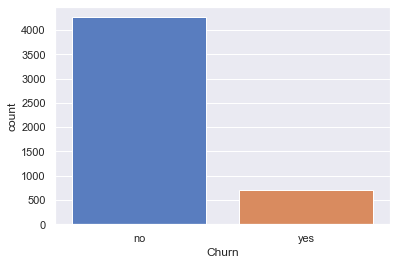

In [33]:
#let's see churn by using countplot
sns.countplot(x=tele_df.Churn)

* After analyzing the churn column, we had little to say like almost 15% of customers have churned.
* let's see what other features say to us and what relation we get after correlated with churn

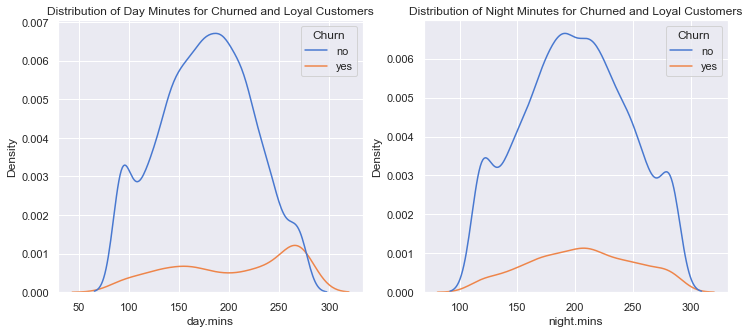

In [34]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

sns.kdeplot(data=tele_df, x='day.mins', hue='Churn', ax=axs[0])
sns.kdeplot(data=tele_df, x='night.mins', hue='Churn', ax=axs[1])

axs[0].set_title('Distribution of Day Minutes for Churned and Loyal Customers')
axs[1].set_title('Distribution of Night Minutes for Churned and Loyal Customers')

plt.show()

** day.mins & night.mins do not have much impact on customer churn 

# Analyzing "Account Length" column

In [35]:
#Separating churn and non churn customers
churn_df     = tele_df[tele_df["Churn"] == bool(True)]
not_churn_df = tele_df[tele_df["Churn"] == bool(False)]

<AxesSubplot:xlabel='account.length', ylabel='Count'>

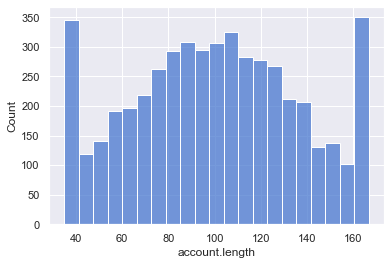

In [36]:
sns.histplot(tele_df['account.length'])

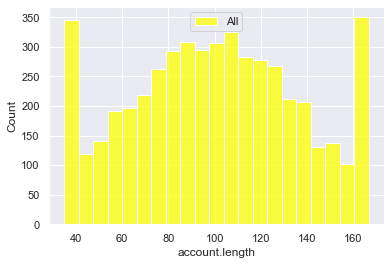

In [37]:
#comparison of churned account length and not churned account length 
sns.histplot(tele_df['account.length'],color = 'yellow',label="All")
sns.histplot(churn_df['account.length'],color = "red",hist=False,label="Churned")
sns.histplot(not_churn_df['account.length'],color = 'green',hist= False,label="Not churned")
plt.legend()

* this plot show effect of account length  on churn
* here is no sign  of customers leaving because of the length  of usage of their account
* After analyzing various aspects of the "account length" column we didn't found any useful relation to churn. so we aren't able to build any connection to the churn as of now. let's see what other features say about the churn.

# Analyzing "International Plan" column

In [38]:
#Show count value of 'yes','no'
tele_df['intl.plan'].value_counts()

no     4498
yes     470
Name: intl.plan, dtype: int64

In [39]:
#Show the unique data of "International plan"
tele_df["intl.plan"].unique()

array(['no', 'yes'], dtype=object)

Text(0, 0.5, 'Count')

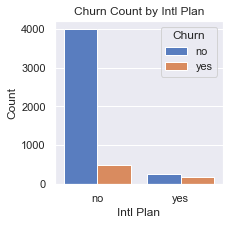

In [40]:
fig, ax = plt.subplots(figsize=(3,3))
sns.countplot(data=tele_df, x='intl.plan', hue='Churn')
ax.set_title('Churn Count by Intl Plan')
ax.set_xlabel('Intl Plan')
ax.set_ylabel('Count')

In [41]:
#Calculate the International Plan vs Churn percentage 
International_plan_data = pd.crosstab(tele_df["intl.plan"],tele_df["Churn"])
International_plan_data['Percentage Churn'] = International_plan_data.apply(lambda x : x[1]*100/(x[0]+x[1]),axis = 1)
print(International_plan_data)

Churn        no  yes  Percentage Churn
intl.plan                             
no         3992  506         11.249444
yes         271  199         42.340426


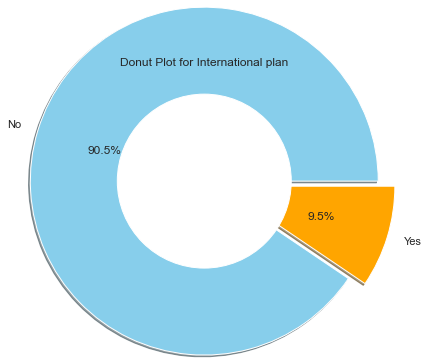

In [42]:
#To get the Donut Plot to analyze International Plan
data = tele_df['intl.plan'].value_counts()
explode = (0, 0.2)
plt.pie(data, explode = explode,autopct='%1.1f%%',shadow=True,radius = 2.0, labels = ['No','Yes'],colors=['skyblue' ,'orange'])
circle = plt.Circle( (0,0), 1, color='white')
p=plt.gcf()
p.gca().add_artist(circle)
plt.title('Donut Plot for International plan')
plt.show()

* There are 3333 people
* 323 have a International Plan 
* 3010 do not have International Plan


<AxesSubplot:xlabel='intl.plan', ylabel='count'>

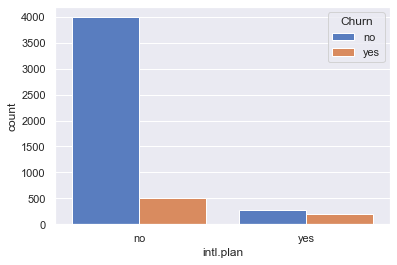

In [43]:
#Analysing by using countplot
sns.countplot(x='intl.plan',hue="Churn",data = tele_df)

This is a count plot which shows the churned and not churned customer respective to their international plan 

From the above data we get

There are 3010 customers who dont have a international plan.

There are 323 customers who have a international plan.

Among those who have a international plan 42.4 % people churn.

Whereas among those who dont have a international plan only 11.4 % people churn.

So basically the people who bought International plans are churning in big numbers.

Probably because of connectivity issues or high call charge.

# Analyzing "Voice Mail Plan" column

In [44]:
#show the unique value of the "Voice mail plan" column
tele_df["voice.plan"].unique()

array(['yes', 'no'], dtype=object)

In [45]:
#Calculate the Voice Mail Plan vs Churn percentage
Voice_mail_plan_data = pd.crosstab(tele_df["voice.plan"],tele_df["Churn"])
Voice_mail_plan_data['Percentage Churn'] = Voice_mail_plan_data.apply(lambda x : x[1]*100/(x[0]+x[1]),axis = 1)
print(Voice_mail_plan_data)

Churn         no  yes  Percentage Churn
voice.plan                             
no          3050  604         16.529830
yes         1213  101          7.686454


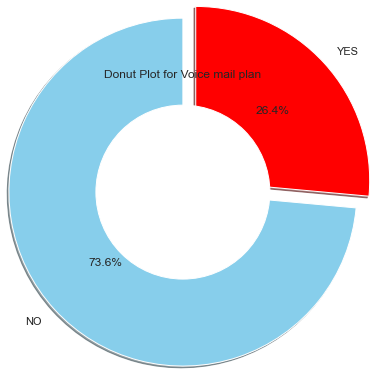

In [46]:
#To get the Donut Plot to analyze Voice mail plan
data = tele_df['voice.plan'].value_counts()
explode = (0, 0.2)
plt.pie(data, explode = explode,autopct='%1.1f%%',startangle=90,shadow=True,radius = 2.0, labels = ['NO','YES'],colors=['skyblue','red'])
circle = plt.Circle( (0,0), 1, color='white')
p=plt.gcf()
p.gca().add_artist(circle)
plt.title('Donut Plot for Voice mail plan')
plt.show()

* There are 3333 people,
* 922 having Voicemail plan, 
* 2411 do not have any Voicemail plan.


<AxesSubplot:xlabel='voice.plan', ylabel='count'>

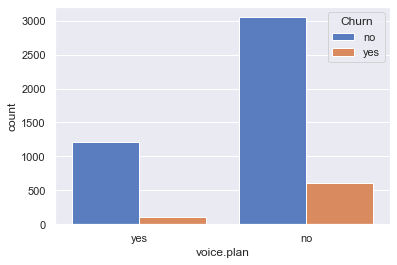

In [47]:
#Analysing by using countplot
sns.countplot(x='voice.plan',hue="Churn",data = tele_df)

* As we can see there is are no clear relation between voice mail plan and churn so we can't clearly say anything so let's move to the next voice mail feature i.e number of voice mail, let's see what it gives to us.
* This plot shows churn corresponding with the subscription of voicemail plan Out of 922 people having Voicemail plan, 8.7% are Churn.


#  Analyzing "Customer service calls" column

In [48]:
#Printing the data of customer service calls 
tele_df['customer.calls'].value_counts()

1.0    1771
2.0    1123
0.0    1016
3.0     660
4.0     398
Name: customer.calls, dtype: int64

In [49]:
#Calculating the Customer service calls vs Churn percentage
Customer_service_calls_data = pd.crosstab(tele_df['customer.calls'],tele_df["Churn"])
Customer_service_calls_data['Percentage_Churn'] = Customer_service_calls_data.apply(lambda x : x[1]*100/(x[0]+x[1]),axis = 1)
print(Customer_service_calls_data)

Churn             no  yes  Percentage_Churn
customer.calls                             
0.0              895  121         11.909449
1.0             1583  188         10.615471
2.0             1001  122         10.863758
3.0              587   73         11.060606
4.0              197  201         50.502513


* This table mapping number of customer calls to the churn percentage
* It’s clear that after 4 calls at least 45% of the subscribers churn.
* Customers with more than 4 service calls their probability of leaving is more

<AxesSubplot:xlabel='customer.calls', ylabel='count'>

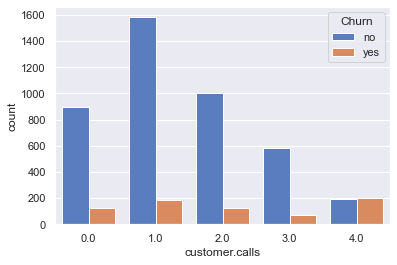

In [50]:
#Analysing using countplot
sns.countplot(x='customer.calls',hue="Churn",data = tele_df)

* It is observed from the above analysis that, mostly because of bad customer service, people tend to leave the operator.

The above data indicating that those customers who called the service center 5 times or above those customer churn percentage is higher than 60%,

And customers who have called once also have a high churn rate indicating their issue was not solved in the first attempt.

So operator should work to improve the service call.

# Analyzing all calls minutes,all calls, all calls charge together

In [51]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['day.calls'].mean())

Churn
no      99.931034
yes    100.845390
Name: day.calls, dtype: float64


In [52]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['day.mins'].mean())

Churn
no     176.664267
yes    203.461582
Name: day.mins, dtype: float64


In [53]:
tele_df['Churn'] = tele_df['Churn'].map({'yes': 1, 'no': 0})

In [54]:
tele_df.head(15)

,area_code,account.length,eve.charge,voice.plan,night.mins,customer.calls,intl.plan,eve.mins,day.charge,voice.messages,day.mins,Churn,intl.mins,intl.calls,intl.charge,day.calls,eve.calls,night.calls,night.charge
0,area_code_415,128.0,16.7800,yes,244.70,1.0,no,197.400,45.0700,25.0,265.100,0,10.0,3.0,2.70,110.0,99.0,91.0,11.0100
1,area_code_415,107.0,16.6200,yes,254.40,1.0,no,195.500,27.4700,26.0,161.600,0,13.7,3.0,3.70,123.0,103.0,103.0,11.4500
2,area_code_415,137.0,10.3000,no,162.60,0.0,no,121.200,41.3800,0.0,243.400,0,12.2,5.0,3.29,114.0,110.0,104.0,7.3200
3,area_code_408,84.0,10.0635,no,196.90,2.0,yes,118.435,46.0965,0.0,271.165,0,6.6,7.0,1.78,71.0,88.0,89.0,8.8600
4,area_code_415,75.0,12.6100,no,186.90,3.0,yes,148.300,28.3400,0.0,166.700,0,10.1,3.0,2.73,113.0,122.0,121.0,8.4100
5,area_code_510,118.0,18.7500,no,203.90,0.0,yes,220.600,37.9800,0.0,223.400,0,6.3,6.0,1.70,98.0,101.0,118.0,9.1800
6,area_code_510,121.0,24.0965,yes,212.60,3.0,no,283.465,37.0900,24.0,218.200,0,7.5,7.0,2.03,88.0,108.0,118.0,9.5700
7,area_code_415,147.0,10.0635,no,211.80,0.0,yes,118.435,26.6900,0.0,157.000,0,7.1,6.0,1.92,79.0,94.0,96.0,9.5300
8,area_code_408,117.0,24.0965,no,215.80,1.0,no,283.465,31.3700,0.0,184.500,0,8.7,4.0,2.35,97.0,80.0,90.0,9.7100
9,area_code_415,141.0,18.8700,yes,283.33,0.0,yes,222.000,43.9600,37.0,258.600,0,11.2,5.0,3.02,84.0,111.0,97.0,12.7465


In [55]:
tele_df.dtypes['Churn']

dtype('int64')

In [56]:
##tele_df["churn"] = tele_df["churn"].astype("float64")


In [57]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['day.charge'].mean())

Churn
0    30.033476
1    34.588385
Name: day.charge, dtype: float64


<AxesSubplot:xlabel='day.mins', ylabel='day.charge'>

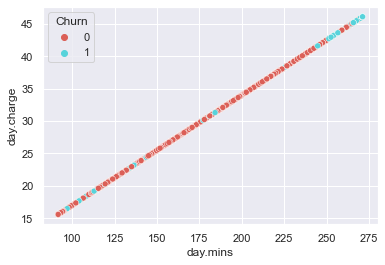

In [58]:
#show the relation using scatter plot
sns.scatterplot(x="day.mins", y="day.charge", hue="Churn", data=tele_df,palette='hls')

<AxesSubplot:xlabel='day.mins', ylabel='day.charge'>

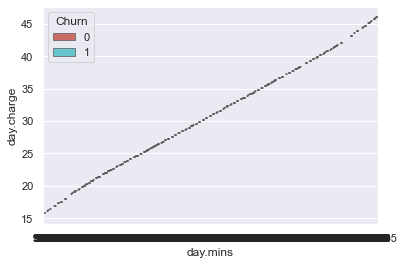

In [59]:
#show the relation using box plot plot
sns.boxplot(x="day.mins", y="day.charge", hue="Churn", data=tele_df,palette='hls')

In [60]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['eve.calls'].mean())

Churn
0    100.206193
1     99.781560
Name: eve.calls, dtype: float64


In [61]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['eve.mins'].mean())

Churn
0    199.054050
1    210.296433
Name: eve.mins, dtype: float64


In [62]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['eve.charge'].mean())

Churn
0    16.919709
1    17.875331
Name: eve.charge, dtype: float64


<AxesSubplot:xlabel='eve.mins', ylabel='eve.charge'>

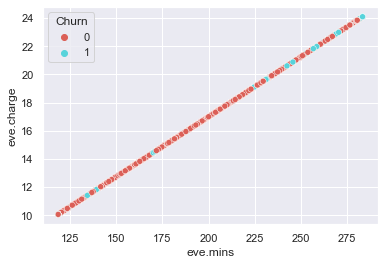

In [63]:
#show the relation using scatter plot
sns.scatterplot(x="eve.mins", y="eve.charge", hue="Churn", data=tele_df,palette='hls')

<AxesSubplot:xlabel='eve.mins', ylabel='eve.charge'>

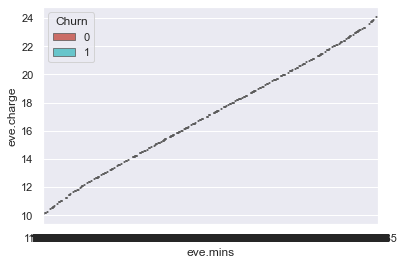

In [64]:
#show the relation using box plot plot
sns.boxplot(x="eve.mins", y="eve.charge", hue="Churn", data=tele_df,palette='hls')

In [65]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['night.calls'].mean())

Churn
0    99.920244
1    99.584397
Name: night.calls, dtype: float64


In [66]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['night.charge'].mean())

Churn
0    8.978533
1    9.251976
Name: night.charge, dtype: float64


In [67]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['night.mins'].mean())

Churn
0    199.527431
1    205.603348
Name: night.mins, dtype: float64


<AxesSubplot:xlabel='night.mins', ylabel='night.charge'>

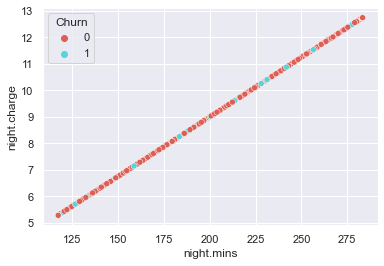

In [68]:
#show the relation using scatter plot
sns.scatterplot(x="night.mins", y="night.charge", hue="Churn", data=tele_df,palette='hls')

<AxesSubplot:xlabel='night.mins', ylabel='night.charge'>

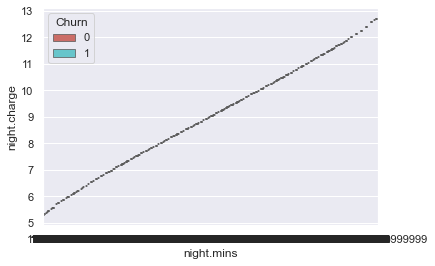

In [69]:
#show the relation using box plot
sns.boxplot(x="night.mins", y="night.charge", hue="Churn", data=tele_df,palette='hls')

In [70]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['intl.mins'].mean())

Churn
0    10.220619
1    10.635887
Name: intl.mins, dtype: float64


In [71]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['intl.calls'].mean())

Churn
0    4.381422
1    4.034043
Name: intl.calls, dtype: float64


In [72]:
#Print the mean value of churned and not churned customer 
print(tele_df.groupby(["Churn"])['intl.charge'].mean())

Churn
0    2.760141
1    2.872213
Name: intl.charge, dtype: float64


<AxesSubplot:xlabel='intl.mins', ylabel='intl.charge'>

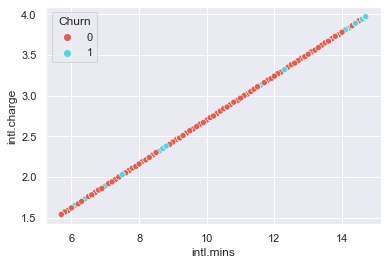

In [73]:
#show the relation using scatter plot
sns.scatterplot(x="intl.mins", y="intl.charge", hue="Churn", data=tele_df,palette='hls')

<AxesSubplot:xlabel='intl.mins', ylabel='intl.charge'>

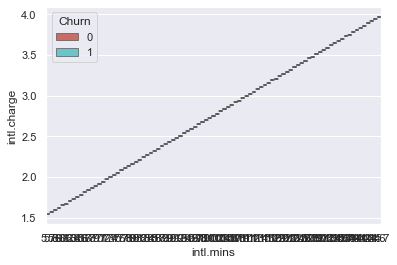

In [74]:
#show the relation using scatter plot
sns.boxplot(x="intl.mins", y="intl.charge", hue="Churn", data=tele_df,palette='hls')

In [75]:
#Deriving a relation between overall call charge and overall call minutes   
day_charge_perm = tele_df['day.charge'].mean()/tele_df['day.mins'].mean()
eve_charge_perm = tele_df['eve.charge'].mean()/tele_df['eve.mins'].mean()
night_charge_perm = tele_df['night.charge'].mean()/tele_df['night.mins'].mean()
int_charge_perm= tele_df['intl.charge'].mean()/tele_df['intl.mins'].mean()

In [76]:
print([day_charge_perm,eve_charge_perm,night_charge_perm,int_charge_perm])


[0.1700025509163114, 0.08500058786564996, 0.0449990146009824, 0.2700551021367263]


<AxesSubplot:>

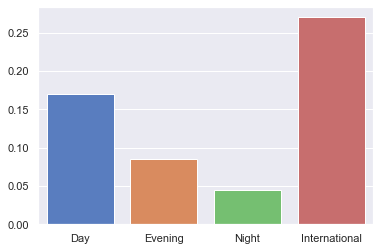

In [77]:
sns.barplot(x=['Day','Evening','Night','International'],y=[day_charge_perm,eve_charge_perm,night_charge_perm,int_charge_perm])

Below this bar plot shows the comparison between all call charges per minute
International call charges are high as compare to others it's an obvious thing but that may be a cause for international plan customers to churn out.

After analyzing the above dataset we have noticed that total day/night/eve minutes/call/charges are not put any kind of cause for churn rate. But international call charges are high as compare to others it's an obvious thing but that may be a cause for international plan customers to churn out.

# Graphical  Visualisation Analysis

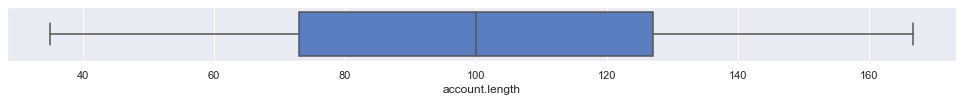

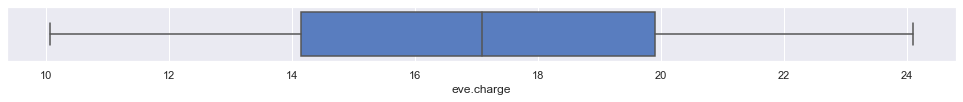

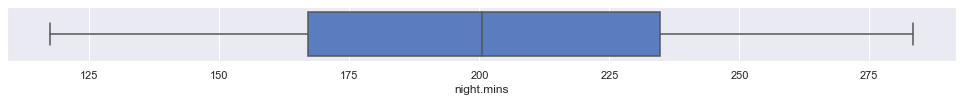

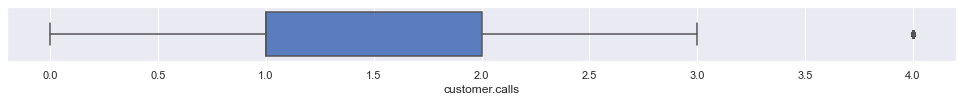

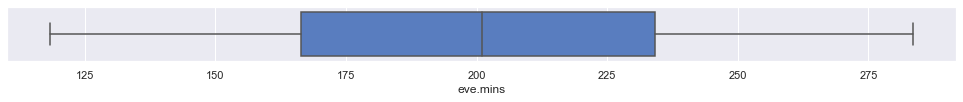

...

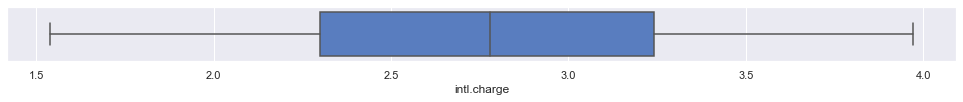

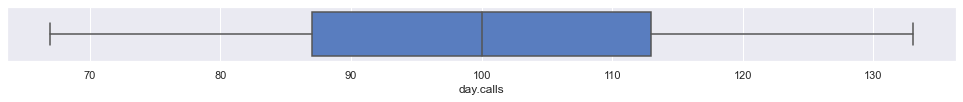

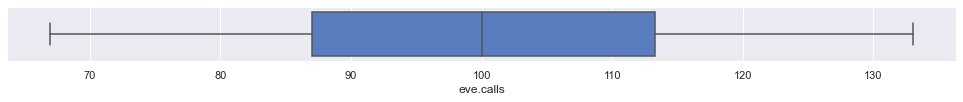

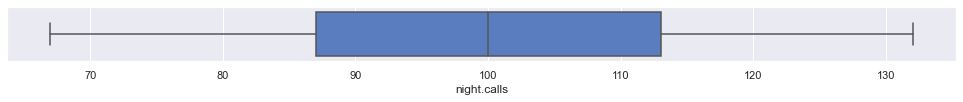

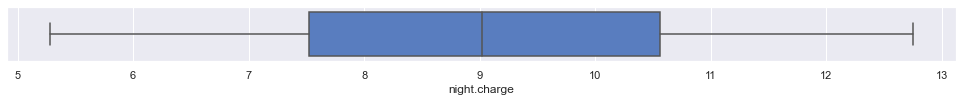

In [78]:
#Printing boxplot for each numerical column present in the data set
df1=tele_df.select_dtypes(exclude=['object','bool'])
for column in df1:
        plt.figure(figsize=(17,1))
        sns.boxplot(data=df1, x=column)
plt.show()

<Figure size 1224x72 with 0 Axes>

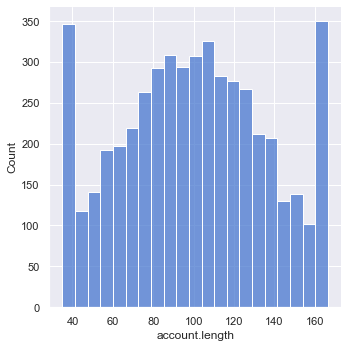

<Figure size 1224x72 with 0 Axes>

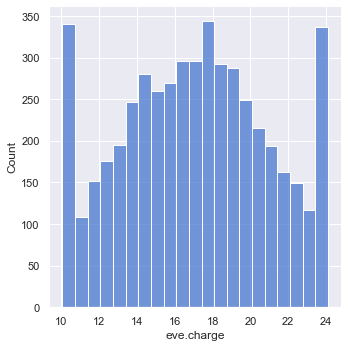

<Figure size 1224x72 with 0 Axes>

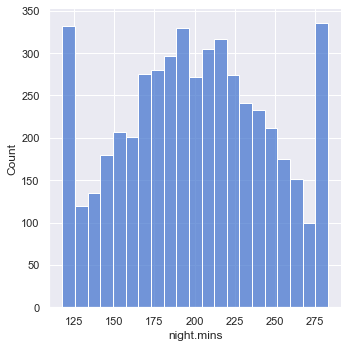

<Figure size 1224x72 with 0 Axes>

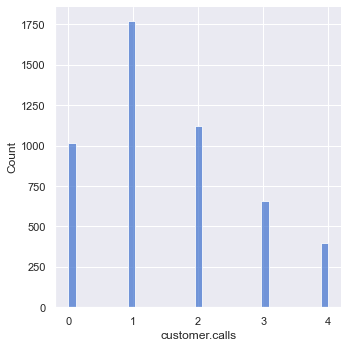

<Figure size 1224x72 with 0 Axes>

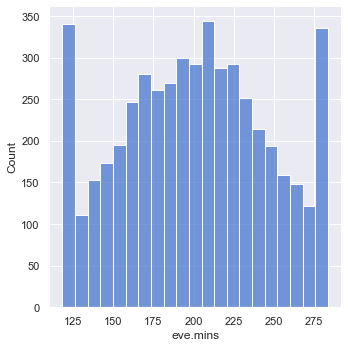

<Figure size 1224x72 with 0 Axes>

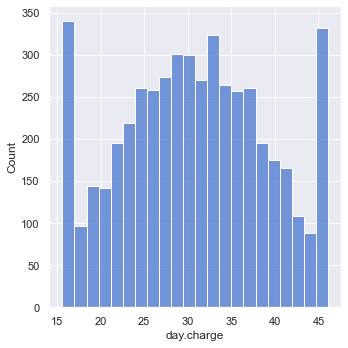

<Figure size 1224x72 with 0 Axes>

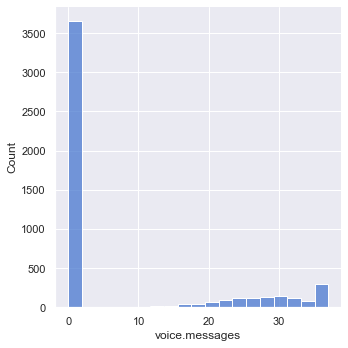

<Figure size 1224x72 with 0 Axes>

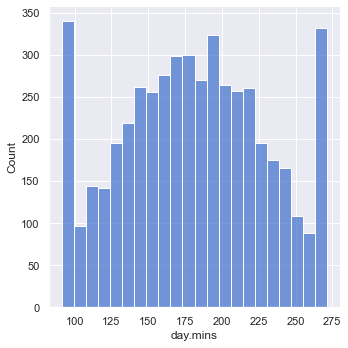

<Figure size 1224x72 with 0 Axes>

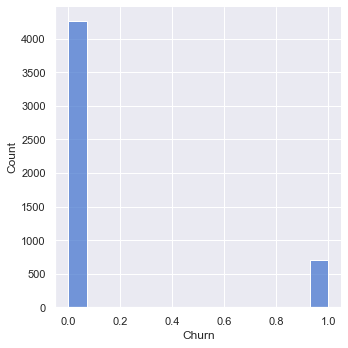

<Figure size 1224x72 with 0 Axes>

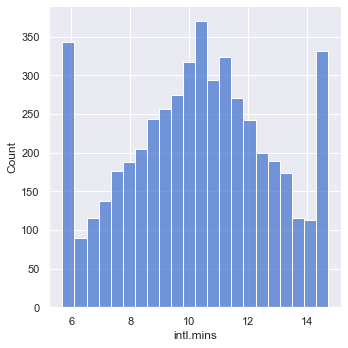

<Figure size 1224x72 with 0 Axes>

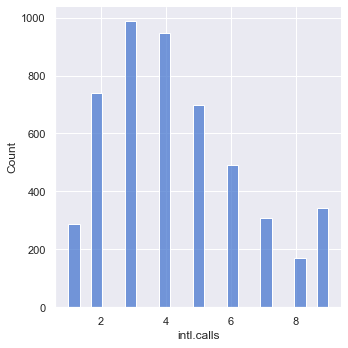

<Figure size 1224x72 with 0 Axes>

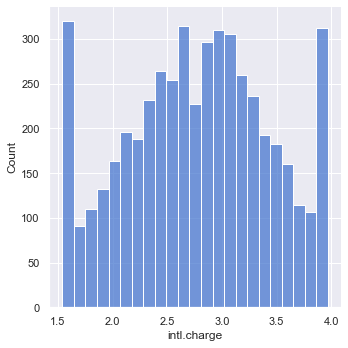

<Figure size 1224x72 with 0 Axes>

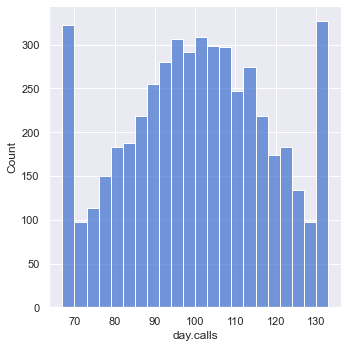

<Figure size 1224x72 with 0 Axes>

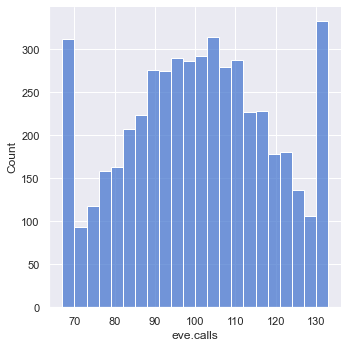

<Figure size 1224x72 with 0 Axes>

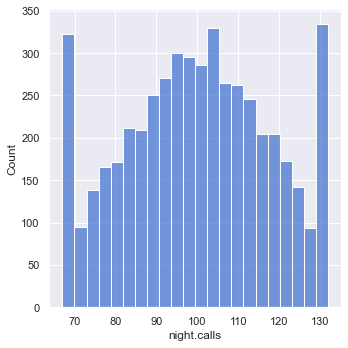

<Figure size 1224x72 with 0 Axes>

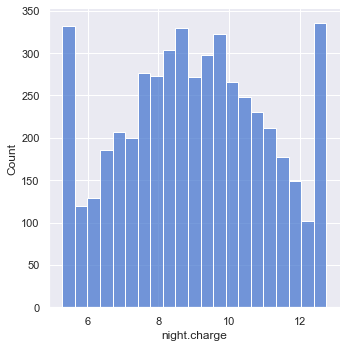

In [79]:
#Printing displot for each numerical column present in the data set
df1=tele_df.select_dtypes(exclude=['object','bool'])
for column in df1:
        plt.figure(figsize=(17,1))
        sns.displot(data=df1, x=column)
plt.show()

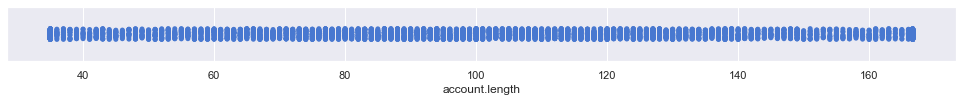

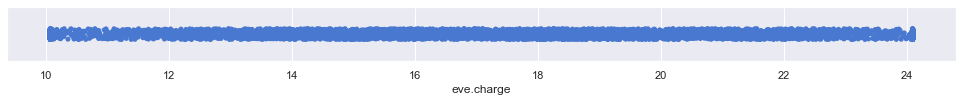

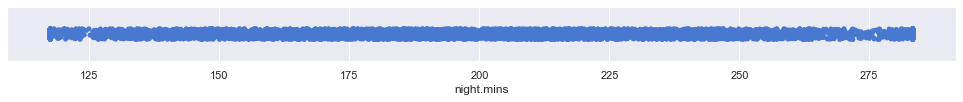

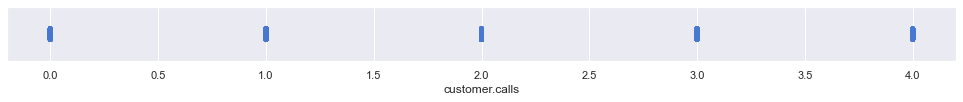

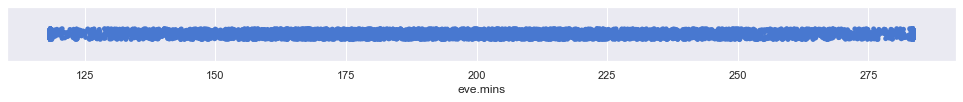

...

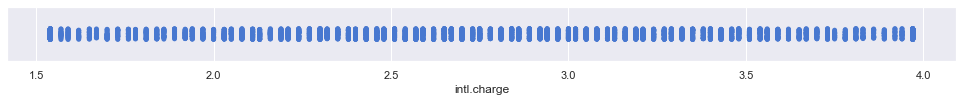

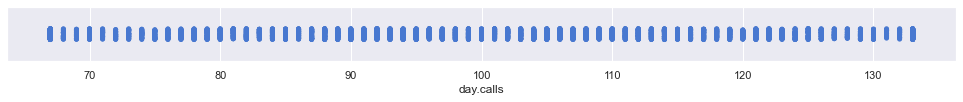

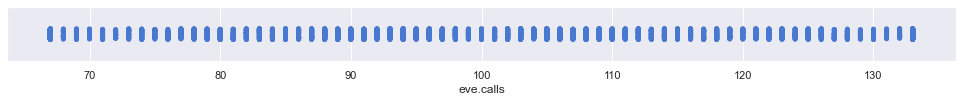

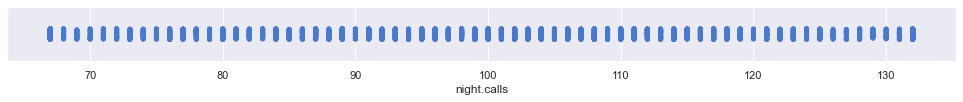

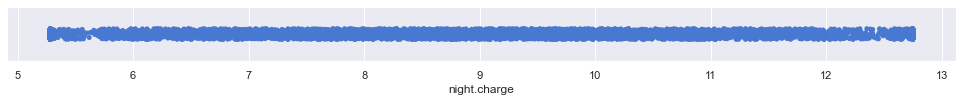

In [80]:
#Printing strip plot for each numerical column present in the data set
df1=tele_df.select_dtypes(exclude=['object','bool'])
for column in df1:
        plt.figure(figsize=(17,1))
        sns.stripplot(data=df1, x=column)
plt.show()

## Univariate Plots

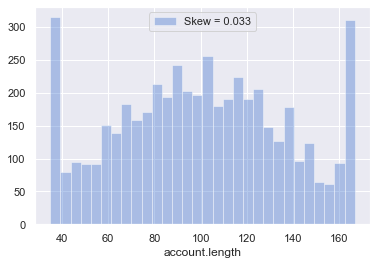

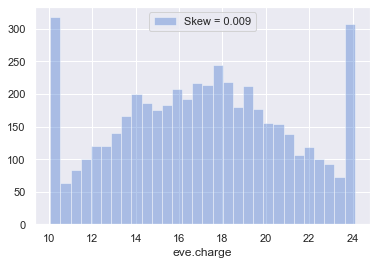

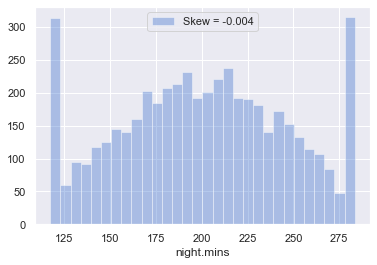

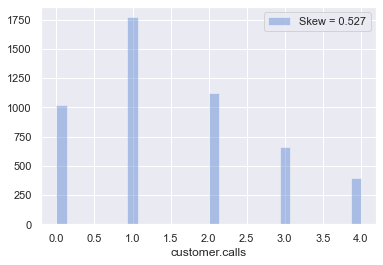

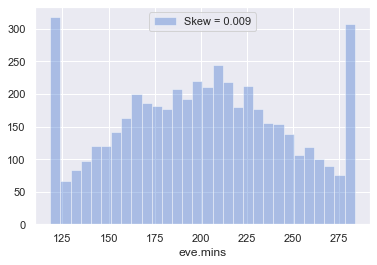

...

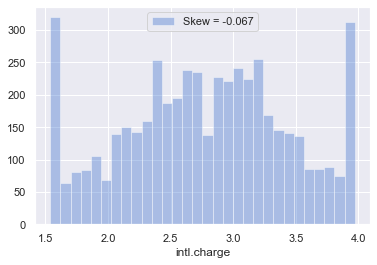

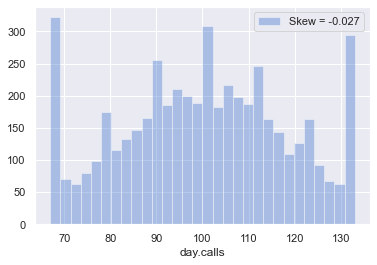

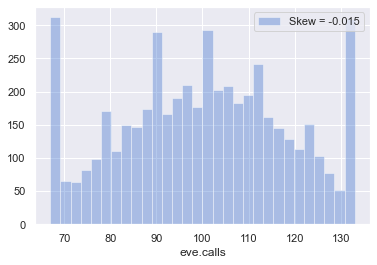

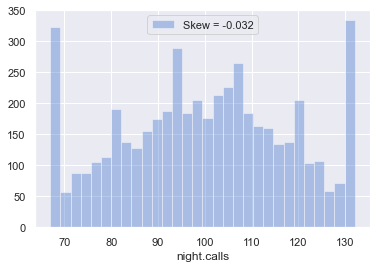

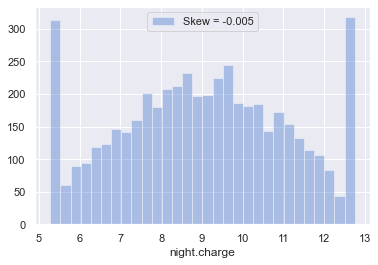

In [81]:
numerical_features=[feature for feature in tele_df.columns if tele_df[feature].dtypes != 'O']
for feat in numerical_features:
    skew = tele_df[feat].skew()
    sns.distplot(tele_df[feat], kde= False, label='Skew = %.3f' %(skew), bins=30)
    plt.legend(loc='best')
    plt.show()

In [82]:
def outlier_hunt(tele_df):
    """
    Takes a dataframe df of features and returns a list of the indices
    corresponding to the observations containing more than 2 outliers. 
    """
    outlier_indices = []
    
    # iterate over features(columns)
    for col in tele_df.columns.tolist():
        # 1st quartile (25%)
        Q1 = np.percentile(tele_df[col], 25)
        
        # 3rd quartile (75%)
        Q3 = np.percentile(tele_df[col],75)
        
        # Interquartile rrange (IQR)
        IQR = Q3 - Q1
        
        # outlier step
        outlier_step = 1.5 * IQR
        
        # Determine a list of indices of outliers for feature col
        outlier_list_col = tele_df[(tele_df[col] < Q1 - outlier_step) | (tele_df[col] > Q3 + outlier_step )].index
        
        # append the found outlier indices for col to the list of outlier indices 
        outlier_indices.extend(outlier_list_col)
        
    # select observations containing more than 2 outliers
    import collections
    outlier_indices = collections.Counter(outlier_indices)        
    multiple_outliers = list( k for k, v in outlier_indices.items() if v > 2 )
    
    return multiple_outliers   

print('The dataset contains %d observations with more than 2 outliers' %(len(outlier_hunt(tele_df[numerical_features])))) 

The dataset contains 0 observations with more than 2 outliers


In [83]:
#We are using correlation plot,correlation matrix, correletaion heatmap, pair plot

# Feature Scaling

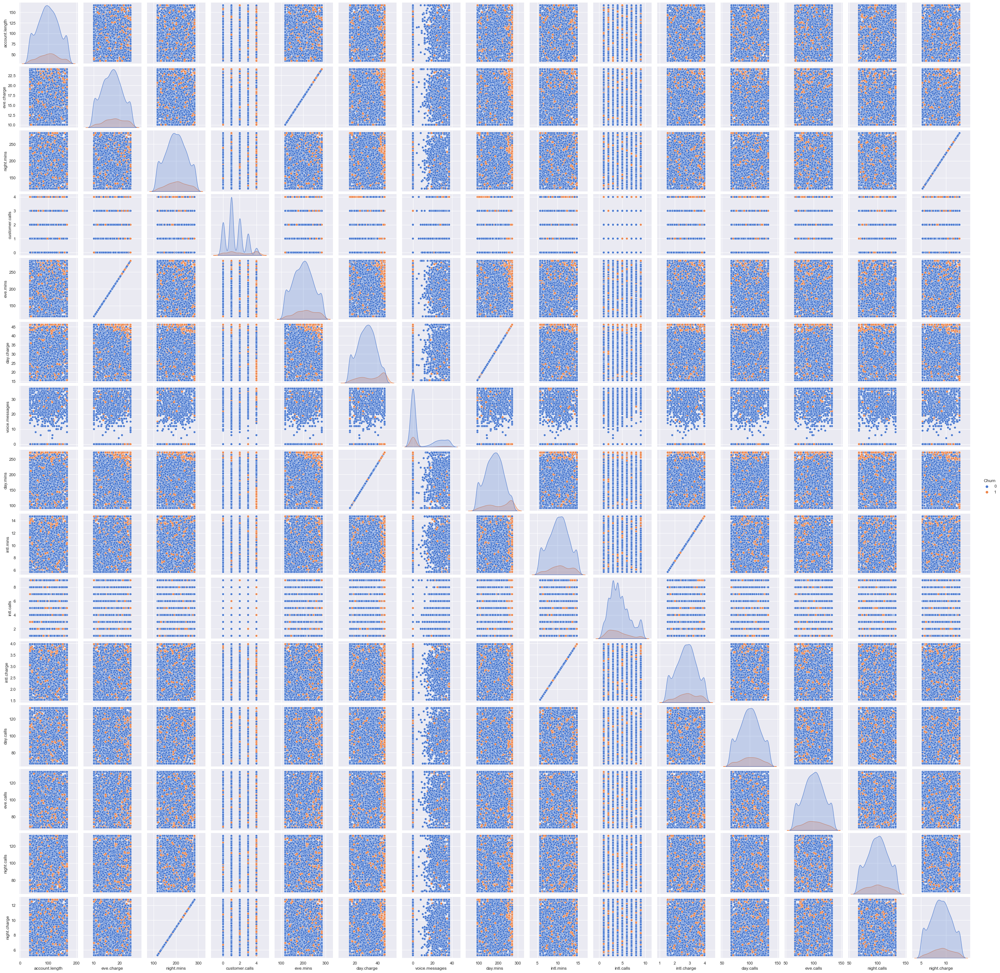

In [84]:
# let's plot pair plot to visualise the attributes all at once
import seaborn as sns
sns.pairplot(data=df1, hue = 'Churn')

In [85]:
data_ = df1.copy()
data_.drop('Churn',axis=1, inplace =True)
data_ = pd.get_dummies(data_.iloc[:,:-1])
data_.head()

,account.length,eve.charge,night.mins,customer.calls,eve.mins,day.charge,voice.messages,day.mins,intl.mins,intl.calls,intl.charge,day.calls,eve.calls,night.calls
0,128.0,16.7800,244.7,1.0,197.400,45.0700,25.0,265.100,10.0,3.0,2.70,110.0,99.0,91.0
1,107.0,16.6200,254.4,1.0,195.500,27.4700,26.0,161.600,13.7,3.0,3.70,123.0,103.0,103.0
2,137.0,10.3000,162.6,0.0,121.200,41.3800,0.0,243.400,12.2,5.0,3.29,114.0,110.0,104.0
3,84.0,10.0635,196.9,2.0,118.435,46.0965,0.0,271.165,6.6,7.0,1.78,71.0,88.0,89.0
4,75.0,12.6100,186.9,3.0,148.300,28.3400,0.0,166.700,10.1,3.0,2.73,113.0,122.0,121.0


# 1)Correlation

<AxesSubplot:>

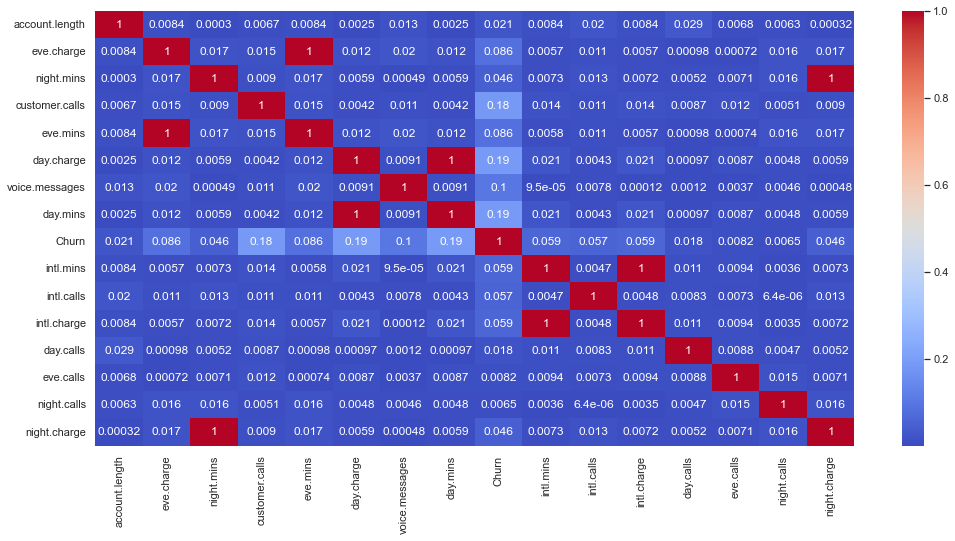

In [86]:
## plot the Correlation matrix
plt.figure(figsize=(17,8))
correlation=tele_df.corr()
sns.heatmap(abs(correlation), annot=True, cmap='coolwarm')

In [87]:
df=tele_df.copy()

In [88]:
df.corr()["Churn"].sort_values()

voice.messages   -0.100446
intl.calls       -0.056769
eve.calls        -0.008194
night.calls      -0.006475
day.calls         0.017670
account.length    0.020701
night.mins        0.046249
night.charge      0.046255
intl.charge       0.058950
intl.mins         0.058970
eve.charge        0.085625
eve.mins          0.085635
customer.calls    0.184003
day.charge        0.189619
day.mins          0.189639
Churn             1.000000
Name: Churn, dtype: float64

#unnecessary columns
voice_mail_plan          -0.102148
voice_mail_messages      -0.089728
international_calls      -0.052844
night_calls               0.006141
evening_calls             0.009233

In [89]:
df1=tele_df.copy()
df1['Churn_Cat'] = tele_df['Churn'].replace({1: 'yes', 0: 'no'})
df1.head()

,area_code,account.length,eve.charge,voice.plan,night.mins,customer.calls,intl.plan,eve.mins,day.charge,voice.messages,day.mins,Churn,intl.mins,intl.calls,intl.charge,day.calls,eve.calls,night.calls,night.charge,Churn_Cat
0,area_code_415,128.0,16.7800,yes,244.7,1.0,no,197.400,45.0700,25.0,265.100,0,10.0,3.0,2.70,110.0,99.0,91.0,11.01,no
1,area_code_415,107.0,16.6200,yes,254.4,1.0,no,195.500,27.4700,26.0,161.600,0,13.7,3.0,3.70,123.0,103.0,103.0,11.45,no
2,area_code_415,137.0,10.3000,no,162.6,0.0,no,121.200,41.3800,0.0,243.400,0,12.2,5.0,3.29,114.0,110.0,104.0,7.32,no
3,area_code_408,84.0,10.0635,no,196.9,2.0,yes,118.435,46.0965,0.0,271.165,0,6.6,7.0,1.78,71.0,88.0,89.0,8.86,no
4,area_code_415,75.0,12.6100,no,186.9,3.0,yes,148.300,28.3400,0.0,166.700,0,10.1,3.0,2.73,113.0,122.0,121.0,8.41,no


In [90]:
data_ = df1.copy()
data_.drop('Churn',axis=1, inplace =True)
data_ = pd.get_dummies(data_.iloc[:,:-1])
data_.head()

,account.length,eve.charge,night.mins,customer.calls,eve.mins,day.charge,voice.messages,day.mins,intl.mins,intl.calls,...,eve.calls,night.calls,night.charge,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,voice.plan_no,voice.plan_yes,intl.plan_no,intl.plan_yes
0,128.0,16.7800,244.7,1.0,197.400,45.0700,25.0,265.100,10.0,3.0,...,99.0,91.0,11.01,0,1,0,0,1,1,0
1,107.0,16.6200,254.4,1.0,195.500,27.4700,26.0,161.600,13.7,3.0,...,103.0,103.0,11.45,0,1,0,0,1,1,0
2,137.0,10.3000,162.6,0.0,121.200,41.3800,0.0,243.400,12.2,5.0,...,110.0,104.0,7.32,0,1,0,1,0,1,0
3,84.0,10.0635,196.9,2.0,118.435,46.0965,0.0,271.165,6.6,7.0,...,88.0,89.0,8.86,1,0,0,1,0,0,1
4,75.0,12.6100,186.9,3.0,148.300,28.3400,0.0,166.700,10.1,3.0,...,122.0,121.0,8.41,0,1,0,1,0,0,1


In [91]:
data_['Churn'] = df1.Churn_Cat
data_.head()

,account.length,eve.charge,night.mins,customer.calls,eve.mins,day.charge,voice.messages,day.mins,intl.mins,intl.calls,...,night.calls,night.charge,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,voice.plan_no,voice.plan_yes,intl.plan_no,intl.plan_yes,Churn
0,128.0,16.7800,244.7,1.0,197.400,45.0700,25.0,265.100,10.0,3.0,...,91.0,11.01,0,1,0,0,1,1,0,no
1,107.0,16.6200,254.4,1.0,195.500,27.4700,26.0,161.600,13.7,3.0,...,103.0,11.45,0,1,0,0,1,1,0,no
2,137.0,10.3000,162.6,0.0,121.200,41.3800,0.0,243.400,12.2,5.0,...,104.0,7.32,0,1,0,1,0,1,0,no
3,84.0,10.0635,196.9,2.0,118.435,46.0965,0.0,271.165,6.6,7.0,...,89.0,8.86,1,0,0,1,0,0,1,no
4,75.0,12.6100,186.9,3.0,148.300,28.3400,0.0,166.700,10.1,3.0,...,121.0,8.41,0,1,0,1,0,0,1,no


In [92]:
le = LabelEncoder()
le.fit(data_["Churn"])
data_["Churn"]=le.transform(data_["Churn"])
data_.head()

,account.length,eve.charge,night.mins,customer.calls,eve.mins,day.charge,voice.messages,day.mins,intl.mins,intl.calls,...,night.calls,night.charge,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,voice.plan_no,voice.plan_yes,intl.plan_no,intl.plan_yes,Churn
0,128.0,16.7800,244.7,1.0,197.400,45.0700,25.0,265.100,10.0,3.0,...,91.0,11.01,0,1,0,0,1,1,0,0
1,107.0,16.6200,254.4,1.0,195.500,27.4700,26.0,161.600,13.7,3.0,...,103.0,11.45,0,1,0,0,1,1,0,0
2,137.0,10.3000,162.6,0.0,121.200,41.3800,0.0,243.400,12.2,5.0,...,104.0,7.32,0,1,0,1,0,1,0,0
3,84.0,10.0635,196.9,2.0,118.435,46.0965,0.0,271.165,6.6,7.0,...,89.0,8.86,1,0,0,1,0,0,1,0
4,75.0,12.6100,186.9,3.0,148.300,28.3400,0.0,166.700,10.1,3.0,...,121.0,8.41,0,1,0,1,0,0,1,0


In [93]:
#Feature importance
from numpy import set_printoptions
from sklearn.feature_selection import SelectKBest, chi2

# split into input (X) and output (y) variables
X = data_.iloc[:, :-1]

y=  data_.Churn

# feature extraction
test = SelectKBest(score_func=chi2, k=4)
fit = test.fit(X, y)

In [94]:
# summarize scores
scores = fit.scores_

features = fit.transform(X)

In [95]:
score_df = pd.DataFrame(list(zip(scores, X.columns)),
               columns =['Score', 'Feature'])
score_df.sort_values(by="Score", ascending=False, inplace=True)
score_df

,Score,Feature
7,2407.174373,day.mins
6,1136.572988,voice.messages
5,409.099592,day.charge
4,381.067267,eve.mins
21,305.844849,intl.plan_yes
3,154.665111,customer.calls
2,111.447700,night.mins
19,45.652468,voice.plan_yes
1,32.391795,eve.charge
20,31.957999,intl.plan_no


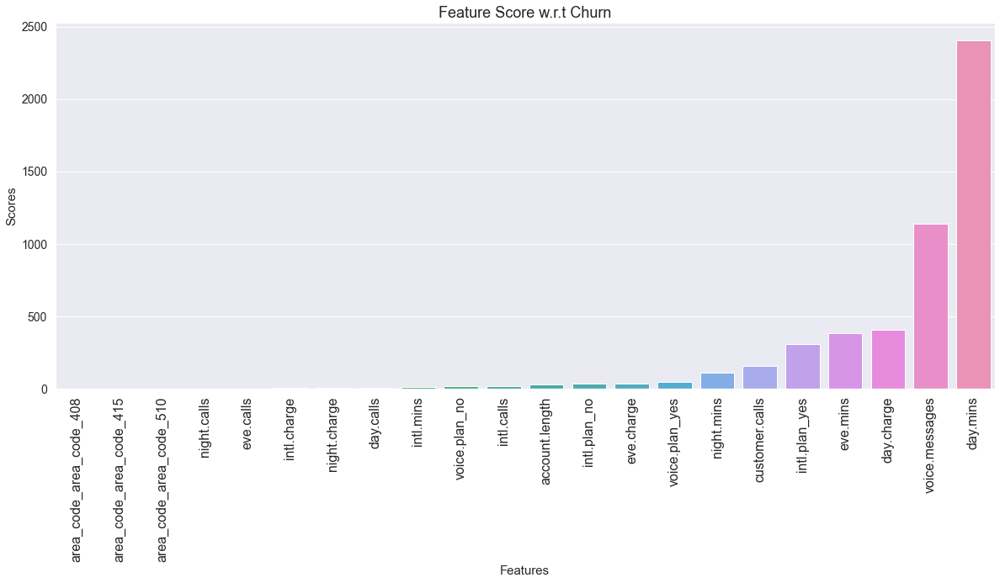

In [96]:
plt.figure(figsize=(20,8))
# make barplot and sort bars
sns.barplot(x='Feature',
            y="Score", 
            data=score_df, 
            order=score_df.sort_values('Score').Feature)
# set labels
plt.xlabel("Features", size=15)
plt.ylabel("Scores", size=15)
plt.yticks(rotation = 0, fontsize = 14)
plt.xticks(rotation = 90, fontsize = 16)
plt.title("Feature Score w.r.t Churn", size=18)
plt.show()

In [97]:
model_data = data_[['day.mins', 'voice.messages','day.charge', 'eve.mins', 'intl.plan_yes', 'customer.calls', 'night.mins', 'voice.plan_yes','eve.charge', 'intl.plan_no', 'account.length', 'Churn']]
model_data.head(20)

,day.mins,voice.messages,day.charge,eve.mins,intl.plan_yes,customer.calls,night.mins,voice.plan_yes,eve.charge,intl.plan_no,account.length,Churn
0,265.100,25.0,45.0700,197.400,0,1.0,244.70,1,16.7800,1,128.0,0
1,161.600,26.0,27.4700,195.500,0,1.0,254.40,1,16.6200,1,107.0,0
2,243.400,0.0,41.3800,121.200,0,0.0,162.60,0,10.3000,1,137.0,0
3,271.165,0.0,46.0965,118.435,1,2.0,196.90,0,10.0635,0,84.0,0
4,166.700,0.0,28.3400,148.300,1,3.0,186.90,0,12.6100,0,75.0,0
5,223.400,0.0,37.9800,220.600,1,0.0,203.90,0,18.7500,0,118.0,0
6,218.200,24.0,37.0900,283.465,0,3.0,212.60,1,24.0965,1,121.0,0
7,157.000,0.0,26.6900,118.435,1,0.0,211.80,0,10.0635,0,147.0,0
8,184.500,0.0,31.3700,283.465,0,1.0,215.80,0,24.0965,1,117.0,0
9,258.600,37.0,43.9600,222.000,1,0.0,283.33,1,18.8700,0,141.0,0


### Test Train Split With Imbalanced Dataset

In [98]:
x = model_data.drop('Churn',axis=1)
y = model_data['Churn']

In [99]:
y.unique()

array([0, 1])

In [100]:
# Create StratifiedKFold object.
skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)

# enumerate the splits and summarize the distributions
for train_ix, test_ix in skf.split(x, y):
# select rows
    train_X, test_X = x.iloc[train_ix], x.loc[test_ix]
    train_y, test_y = y.iloc[train_ix], y.iloc[test_ix]
# summarize train and test composition
counter_train = Counter(train_y)
counter_test = Counter(test_y)
print('Training Data',counter_train,'Testing Data',counter_test)

Training Data Counter({0: 3837, 1: 635}) Testing Data Counter({0: 426, 1: 70})


In [101]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.3,random_state=0,stratify=y)

In [102]:
# summarize train and test composition
counter_train = Counter(y_train)
counter_test = Counter(y_test)
print('Training Data',counter_train,'Testing Data',counter_test)

Training Data Counter({0: 2984, 1: 493}) Testing Data Counter({0: 1279, 1: 212})


In [103]:
print("Shape of X_train: ",x_train.shape)
print("Shape of X_test: ", x_test.shape)
print("Shape of y_train: ",y_train.shape)
print("Shape of y_test",y_test.shape)

Shape of X_train:  (3477, 11)
Shape of X_test:  (1491, 11)
Shape of y_train:  (3477,)
Shape of y_test (1491,)


# Model Building

In [104]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score




base_estimator = DecisionTreeClassifier(max_depth=1)
n_estimators = 50
learning_rate = 1

ada = AdaBoostClassifier(base_estimator=base_estimator, n_estimators=n_estimators, learning_rate=learning_rate)

ada.fit(x_train, y_train)

y_pred = ada.predict(x_test)

accuracy = accuracy_score(y_test, y_pred)

print("Accuracy:", accuracy)
print(classification_report(y_test, y_pred) )

Accuracy: 0.8678739101274312
              precision    recall  f1-score   support

           0       0.89      0.96      0.93      1279
           1       0.57      0.28      0.38       212

    accuracy                           0.87      1491
   macro avg       0.73      0.62      0.65      1491
weighted avg       0.84      0.87      0.85      1491



In [105]:
# Import necessary libraries
from sklearn.neighbors import KNeighborsClassifier


# Create KNN classifier with k=3
knn = KNeighborsClassifier(n_neighbors=3)

# Fit the model with training data
knn.fit(x_train, y_train)

# Predict the classes of testing data
y_pred = knn.predict(x_test)

# Evaluate the accuracy of the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print(
      classification_report(y_test, y_pred))

Accuracy: 0.8658618376928237
              precision    recall  f1-score   support

           0       0.90      0.96      0.92      1279
           1       0.55      0.33      0.41       212

    accuracy                           0.87      1491
   macro avg       0.72      0.64      0.67      1491
weighted avg       0.85      0.87      0.85      1491



In [107]:
# Import necessary libraries
from sklearn.ensemble import RandomForestClassifier


# Create Random Forest classifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the model with training data
rf.fit(x_train, y_train)

# Predict the classes of testing data
y_pred = rf.predict(x_test)

# Evaluate the accuracy of the model
print("Accuracy:", accuracy_score(y_pred, y_test))
print(classification_report(y_test, y_pred) )

Accuracy: 0.9141515761234071
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      1279
           1       0.78      0.55      0.65       212

    accuracy                           0.91      1491
   macro avg       0.85      0.76      0.80      1491
weighted avg       0.91      0.91      0.91      1491



In [108]:
from sklearn.ensemble import GradientBoostingClassifier



# Create Gradient Boosting classifier
gb = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, random_state=42)

# Fit the model with training data
gb.fit(x_train, y_train)

# Predict the classes of testing data
y_pred = gb.predict(x_test)

# Evaluate the accuracy of the model
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred) )

Accuracy: 0.9181757209926223
              precision    recall  f1-score   support

           0       0.93      0.98      0.95      1279
           1       0.81      0.56      0.66       212

    accuracy                           0.92      1491
   macro avg       0.87      0.77      0.81      1491
weighted avg       0.91      0.92      0.91      1491



### Grid search using Stratified Kfold Splits on Imbalanced Dataset

In [109]:
def print_score(clf, X_train, y_train, X_test, y_test, train=True):
    if train:
        pred = clf.predict(X_train)
        clf_report = pd.DataFrame(classification_report(y_train, pred, output_dict=True))
        print("Train Result:\n================================================")
        print(f"Accuracy Score: {accuracy_score(y_train, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_train, pred)}\n")
        
    elif train==False:
        pred = clf.predict(X_test)
        clf_report = pd.DataFrame(classification_report(y_test, pred, output_dict=True))
        print("Test Result:\n================================================")        
        print(f"Accuracy Score: {accuracy_score(y_test, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_test, pred)}\n")

In [110]:
from sklearn.ensemble import RandomForestClassifier

rf_clf = RandomForestClassifier(n_estimators=100)
rf_clf.fit(train_X, train_y)

print_score(rf_clf, train_X, train_y, test_X, test_y, train=True)
print_score(rf_clf, train_X, train_y, test_X, test_y, train=False)

Train Result:
Accuracy Score: 99.98%
_______________________________________________
CLASSIFICATION REPORT:
                     0           1  accuracy    macro avg  weighted avg
precision     0.999739    1.000000  0.999776     0.999870      0.999776
recall        1.000000    0.998425  0.999776     0.999213      0.999776
f1-score      0.999870    0.999212  0.999776     0.999541      0.999776
support    3837.000000  635.000000  0.999776  4472.000000   4472.000000
_______________________________________________
Confusion Matrix: 
 [[3837    0]
 [   1  634]]

Test Result:
Accuracy Score: 91.33%
_______________________________________________
CLASSIFICATION REPORT:
                    0          1  accuracy   macro avg  weighted avg
precision    0.924612   0.800000  0.913306    0.862306      0.907026
recall       0.978873   0.514286  0.913306    0.746579      0.913306
f1-score     0.950969   0.626087  0.913306    0.788528      0.905119
support    426.000000  70.000000  0.913306  496.00000

### Grid search using Train Test Splits Stratifying Target feature on Imbalanced Dataset

In [111]:
from sklearn.ensemble import RandomForestClassifier

rf_clf = RandomForestClassifier(n_estimators=100)
rf_clf.fit(x_train, y_train)

print_score(rf_clf, x_train, y_train, x_test, y_test, train=True)
print_score(rf_clf, x_train, y_train, x_test, y_test, train=False)

Train Result:
Accuracy Score: 100.00%
_______________________________________________
CLASSIFICATION REPORT:
                0      1  accuracy  macro avg  weighted avg
precision     1.0    1.0       1.0        1.0           1.0
recall        1.0    1.0       1.0        1.0           1.0
f1-score      1.0    1.0       1.0        1.0           1.0
support    2984.0  493.0       1.0     3477.0        3477.0
_______________________________________________
Confusion Matrix: 
 [[2984    0]
 [   0  493]]

Test Result:
Accuracy Score: 92.09%
_______________________________________________
CLASSIFICATION REPORT:
                     0           1  accuracy    macro avg  weighted avg
precision     0.931599    0.821918  0.920858     0.876758      0.916003
recall        0.979672    0.566038  0.920858     0.772855      0.920858
f1-score      0.955030    0.670391  0.920858     0.812711      0.914559
support    1279.000000  212.000000  0.920858  1491.000000   1491.000000
____________________________

## Hyper-parameter Tuning 

In [112]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier

# Define the hyperparameter grid
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [5, 10, 20],
    'min_samples_split': [2, 5, 10]
}

# Create a Random Forest classifier
rf_clf = RandomForestClassifier(random_state=42)

# Create a GridSearchCV object
grid_search = GridSearchCV(rf_clf, param_grid=param_grid, cv=5)

# Fit the GridSearchCV object to the data
grid_search.fit(x_train, y_train)

# Get the best estimator from the grid search
best_rf_clf = grid_search.best_estimator_

# Print the best hyperparameters and score
print("Best hyperparameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)

# Print the scores for the best estimator
print_score(best_rf_clf, x_train, y_train, x_test, y_test, train=True)
print_score(best_rf_clf, x_train, y_train, x_test, y_test, train=False)


Best hyperparameters: {'max_depth': 10, 'min_samples_split': 10, 'n_estimators': 50}
Best score: 0.9289605556933763
Train Result:
Accuracy Score: 96.15%
_______________________________________________
CLASSIFICATION REPORT:
                     0           1  accuracy    macro avg  weighted avg
precision     0.960867    0.966234  0.961461     0.963550      0.961628
recall        0.995643    0.754564  0.961461     0.875104      0.961461
f1-score      0.977946    0.847380  0.961461     0.912663      0.959433
support    2984.000000  493.000000  0.961461  3477.000000   3477.000000
_______________________________________________
Confusion Matrix: 
 [[2971   13]
 [ 121  372]]

Test Result:
Accuracy Score: 91.62%
_______________________________________________
CLASSIFICATION REPORT:
                     0           1  accuracy    macro avg  weighted avg
precision     0.928042    0.804196  0.916164     0.866119      0.910432
recall        0.978108    0.542453  0.916164     0.760280      0.9161

## Model Evaluation

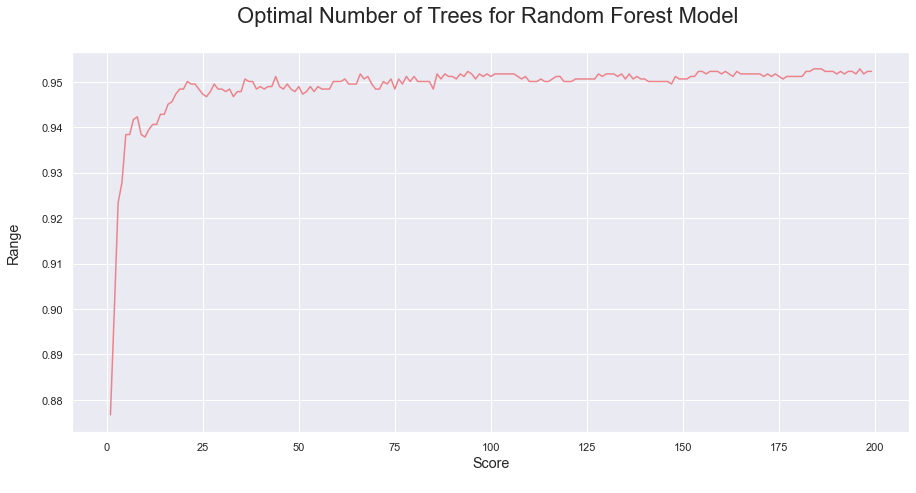

In [134]:
fig = plt.figure(figsize=(15, 7))
plt.plot(range(1,200),score_array, color = '#ec838a')
plt.ylabel('Range\n',horizontalalignment="center",
fontstyle = "normal", fontsize = "large", 
fontfamily = "sans-serif")
plt.xlabel('Score\n',horizontalalignment="center",
fontstyle = "normal", fontsize = "large", 
fontfamily = "sans-serif")
plt.title('Optimal Number of Trees for Random Forest Model \n',horizontalalignment="center", fontstyle = "normal", fontsize = "22", fontfamily = "sans-serif")
#plt.legend(loc='top right', fontsize = "medium")
plt.xticks(rotation=0, horizontalalignment="center")
plt.yticks(rotation=0, horizontalalignment="right")
plt.show()

In [135]:
## Cross Validation
n_estimators = [int(x) for x in np.linspace(start=0, stop=200, num=200)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(10, 110, num=11)]
max_depth.append(None)
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]
bootstrap = [True, False]

random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf, 'bootstrap': bootstrap}

rf_clf = RandomForestClassifier(random_state=42)

rf_cv = RandomizedSearchCV(estimator=rf_clf, scoring='f1',param_distributions=random_grid, n_iter=100, cv=3, 
                               verbose=2, random_state=42, n_jobs=-1)

rf_cv.fit(x_train, y_train)
rf_best_params = rf_cv.best_params_
print(f"Best paramters: {rf_best_params})")

rf_clf = RandomForestClassifier(**rf_best_params)
rf_clf.fit(x_train, y_train)

print_score(rf_clf, x_train, y_train, x_test, y_test, train=True)
print_score(rf_clf, x_train, y_train, x_test, y_test, train=False)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best paramters: {'n_estimators': 169, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 90, 'bootstrap': False})
Train Result:
Accuracy Score: 100.00%
_______________________________________________
CLASSIFICATION REPORT:
                0       1  accuracy  macro avg  weighted avg
precision     1.0     1.0       1.0        1.0           1.0
recall        1.0     1.0       1.0        1.0           1.0
f1-score      1.0     1.0       1.0        1.0           1.0
support    2089.0  2113.0       1.0     4202.0        4202.0
_______________________________________________
Confusion Matrix: 
 [[2089    0]
 [   0 2113]]

Test Result:
Accuracy Score: 95.50%
_______________________________________________
CLASSIFICATION REPORT:
                    0           1  accuracy    macro avg  weighted avg
precision    0.951220    0.958843  0.955025     0.955031      0.955055
recall       0.958659    0.9514

# Making a Predictive System

In [164]:
input_data= pd.DataFrame({'day.mins': [129.100], 
                          'voice.messages': [0], 
                          'day.charge': [21.95], 
                          'eve.mins': [228.500], 
                          'intl.plan_yes': [0], 
                          'customer.calls': [4], 
                          'night.mins': [208.80], 
                          'voice.plan_yes': [0],
                          'eve.charge': [19.4200], 
                          'intl.plan_no': [1], 
                          'account.length': [65.0]})

# Use the predict() method of the loaded model to make predictions for the input data
prediction = rf_clf.predict(input_data)

# Print the predicted value
print(prediction)

if prediction[0] == 0:
    print("This customer is not likely to churn.")
else:
    print("This customer is likely to churn.")

[1]
This customer is likely to churn.


### Saving the Trained model

In [165]:
# Save the trained model
import pickle
with open('rf_model.pkl', 'wb') as file:
    pickle.dump(rf_clf, file)

In [166]:
# Load the model from the file
with open('rf_model.pkl', 'rb') as file:
    saved_model = pickle.load(file)

### Code for WebAppp

In [173]:
import pickle
import streamlit as st

# Load the model from the file
loaded_model = pickle.load(open('C:/Users/Madhu/OneDrive/Documents/Python Scripts/rf_model.pkl', 'rb'))

def Churn(input_data):
    
    # Use the predict() method of the loaded model to make predictions for the input data
    prediction = loaded_model.predict(input_data)

    # Print the predicted value
    print(prediction)

    if prediction[0] == 0:
        return("This customer is not likely to churn.")
    else:
        return("This customer is likely to churn.")
    

    
def main():
    
    # Creating the user interface
    st.title("Customer Churn Prediction App")
    st.sidebar.header("Enter Customer Details")
    
    # Creating input fields for customer information
    day_mins = st.sidebar.number_input("Day Mins")
    voice_messages = st.sidebar.number_input("Voice Messages")
    day_charge = st.sidebar.number_input("Day Charge")
    eve_mins = st.sidebar.number_input("Eve Mins")
    intl_plan_yes = st.sidebar.radio("International Plan (Yes/No)", ["Yes", "No"])
    customer_calls = st.sidebar.number_input("Customer Calls")
    night_mins = st.sidebar.number_input("Night Mins")
    voice_plan_yes = st.sidebar.radio("Voice Plan (Yes/No)", ["Yes", "No"])
    eve_charge = st.sidebar.number_input("Eve Charge")
    intl_plan_no = 1 if intl_plan_yes == "No" else 0
    account_length = st.sidebar.number_input("Account Length")
    
    # Creating a dictionary for the input data
    data = {"day.mins": day_mins, "voice.messages": voice_messages, "day.charge": day_charge, "eve.mins": eve_mins,
        "intl.plan_yes": 1 if intl_plan_yes == "Yes" else 0, "customer.calls": customer_calls, "night.mins": night_mins,
        "voice.plan_yes": 1 if voice_plan_yes == "Yes" else 0, "eve.charge": eve_charge, "intl.plan_no": intl_plan_no,
        "account.length": account_length}
    
    # define the variable intl_plan
    intl_plan = 'Yes'
    voice_plan = 'Yes'
    
    input_data = pd.DataFrame({
    'day.mins': [day_mins], 
    'voice.messages': [voice_messages], 
    'day.charge': [day_charge], 
    'eve.mins': [eve_mins], 
    'intl.plan_yes': [1 if intl_plan.lower() == 'yes' else 0], 
    'customer.calls': [customer_calls], 
    'night.mins': [night_mins], 
    'voice.plan_yes': [1 if voice_plan.lower() == 'yes' else 0],
    'eve.charge': [eve_charge], 
    'intl.plan_no': [0 if intl_plan.lower() == 'yes' else 1], 
    'account.length': [account_length]
})
  
    # Selecting only the required features from the input data
    model_input = input_data[['day.mins', 'voice.messages', 'day.charge', 'eve.mins', 'intl.plan_yes', 'customer.calls',
                          'night.mins', 'voice.plan_yes', 'eve.charge', 'intl.plan_no', 'account.length']]
   
   
    
    prediction = ""
    
    # Loading the trained model using pickle
    with open('rf_model.pkl', 'rb') as f:
        rf_model = pickle.load(f)
       
    #Creating a button for prediction
    if st.sidebar.button("Predict"):
        prediction = rf_model.predict(model_input)
        if prediction[0] == 0:
            st.success("This customer is not likely to churn.")
        else:
            st.error("This customer is likely to churn.")
        
    st.success(prediction)



if __name__ == "__main__":
    main()